# FIFA 19 : A visual data Analysis
* Using data from kaggle **FIFA 19** dataset released by EA Vancouver.
* In this project I have combined my love of football with data science to create My Dream team by analysing data from fifa 19.
<center><h1>SHADAB SAYEED'S DREAM TEAM </h1></center>
![cover](https://i2-prod.walesonline.co.uk/incoming/article14768466.ece/ALTERNATES/s1200/fifa19.jpg)

In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import plotly as py
import plotly.graph_objs as go
import seaborn as sns
sns.set(style = 'dark')
import random
from collections import Counter as counter
from IPython.display import HTML
import os
import warnings

warnings.filterwarnings("ignore")
py.offline.init_notebook_mode(connected = True)

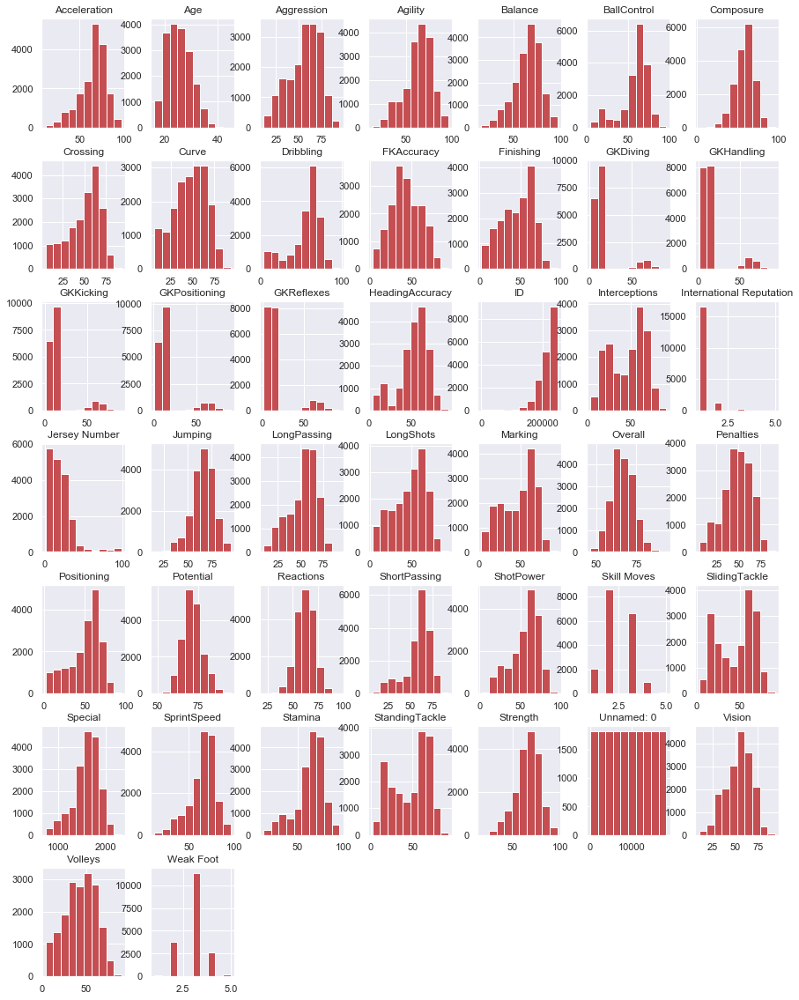

In [3]:
fifa_df = pd.read_csv("fifa19data.csv")
fifa_df.head(10)
fig = plt.figure(figsize = (15,20))
ax = fig.gca()
fifa_df.hist(ax = ax,color='r')
plt.show()

In [4]:
pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 100)

In [5]:
useful_features = ['Name',
                   'Age',
                   'Photo', 
                   'Nationality', 
                   'Flag',
                   'Overall',
                   'Potential', 
                   'Club', 
                   'Club Logo', 
                   'Value',
                   'Wage',
                   'Preferred Foot',
                   'International Reputation',
                   'Weak Foot',
                   'Skill Moves',
                   'Work Rate',
                   'Body Type',
                   'Position',
                   'Joined', 
                   'Contract Valid Until',
                   'Height',
                   'Weight',
                   'Crossing', 
                   'Finishing',
                   'HeadingAccuracy',
                   'ShortPassing', 
                   'Volleys', 
                   'Dribbling',
                   'Curve',
                   'FKAccuracy',
                   'LongPassing',
                   'BallControl',
                   'Acceleration',
                   'SprintSpeed',
                   'Agility',
                   'Reactions', 
                   'Balance',
                   'ShotPower', 
                   'Jumping',
                   'Stamina', 
                   'Strength',
                   'LongShots',
                   'Aggression',
                   'Interceptions',
                   'Positioning', 
                   'Vision', 
                   'Penalties',
                   'Composure',
                   'Marking',
                   'StandingTackle', 
                   'SlidingTackle',
                   'GKDiving',
                   'GKHandling',
                   'GKKicking',
                   'GKPositioning',
                   'GKReflexes']

In [6]:
df = pd.DataFrame(fifa_df , columns = useful_features)

In [7]:
class fast_plot():
    def __init__(self):
        c = ['r' , 'g' , 'b' , 'y' , 'orange' , 'grey' , 'lightcoral' , 'crimson' , 
            'springgreen' , 'teal' , 'c' , 'm' , 'gold' , 'skyblue' , 'darkolivegreen',
            'tomato']
        self.color = c
        
    
    def regplot_one_vs_many(self , x  , y  , data , rows , cols):
        color_used = []
        
        n = 0
        for feature in y:
            
            for i in range(1000):
                colour = random.choice(self.color)
                if colour not in color_used:
                    color_used.append(colour)
                    break
                    
            n += 1 
            plt.subplot(rows , cols , n)
            plt.subplots_adjust(hspace = 0.5 , wspace = 0.5)
            sns.regplot(x  = x , y = feature , data = data , 
                        color = colour)
    
    def bar_plot(self , x = None, y = None, data = None ,x_tick_rotation = None ,xlabel = None , ylabel = None , title = ''):
        ax = sns.barplot(x = x , y = y , data = data , palette = 'rocket')
        rects = ax.patches
        for rect , label in zip(rects , data[y]):
            height = rect.get_height()
            ax.text(rect.get_x() + rect.get_width() / 2, height + (height * 0.1 /100), round(label,1),
                    ha='center', va='bottom')
        if not xlabel == None and not ylabel == None:
            plt.xlabel(xlabel)
            plt.ylabel(ylabel)
        if not x_tick_rotation == None:
            plt.xticks(rotation = x_tick_rotation)
        plt.title(title)
        
        
plots = (fast_plot())

 # Analysis

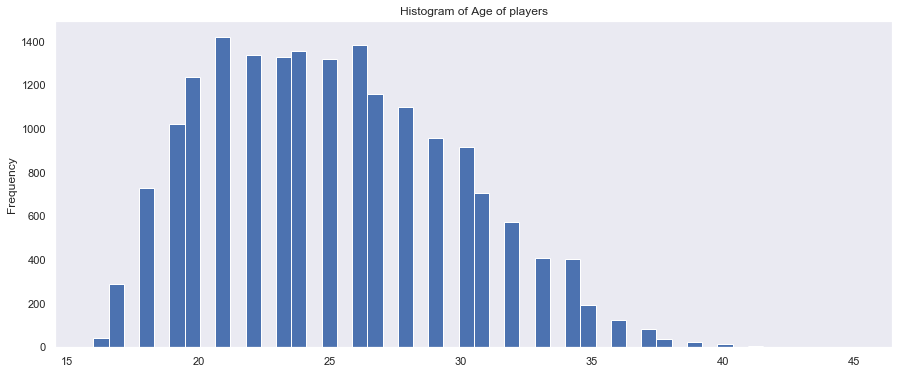

In [8]:
plt.figure(1 , figsize = (15 , 6))
df['Age'].plot(kind = 'hist' , bins = 50)
plt.title('Histogram of Age of players')
plt.show()

## 5 eldest players

In [15]:
df.sort_values(by = 'Age' , ascending = False)[['Name','Club','Nationality'
                                               ,'Overall', 'Age' ]].head(5)

,Name,Club,Nationality,Overall,Age
4741,O. Pérez,Pachuca,Mexico,71,45
18183,K. Pilkington,Cambridge United,England,48,44
17726,T. Warner,Accrington Stanley,Trinidad & Tobago,53,44
10545,S. Narazaki,Nagoya Grampus,Japan,65,42
7225,C. Muñoz,CD Universidad de Concepción,Argentina,68,41


## 5 youngest players

In [16]:
df.sort_values(by = 'Age' , ascending = True)[['Name','Age','Club','Nationality'
                                               ,'Overall' ]].head(5)

,Name,Age,Club,Nationality,Overall
18206,G. Nugent,16,Tranmere Rovers,England,46
17743,J. Olstad,16,Sarpsborg 08 FF,Norway,52
13293,H. Massengo,16,AS Monaco,France,62
16081,J. Italiano,16,Perth Glory,Australia,58
18166,N. Ayéva,16,Örebro SK,Sweden,48


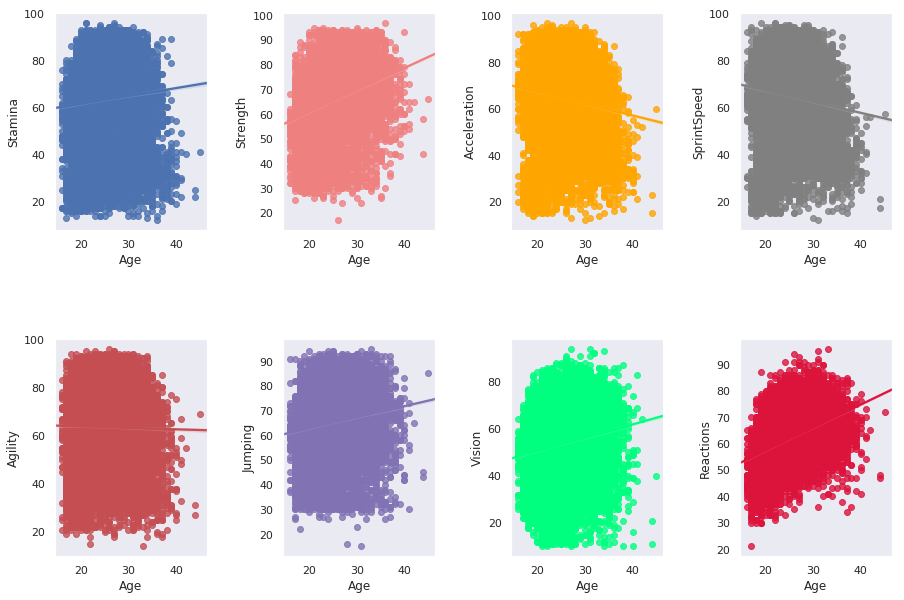

In [17]:
vals = ['Stamina' , 'Strength' , 'Acceleration','SprintSpeed' , 'Agility' , 'Jumping' ,
       'Vision','Reactions']
plt.figure(1 , figsize = (15 , 10))
plots.regplot_one_vs_many(x = 'Age' , y = vals , data = df , rows = 2 , cols = 4 )
plt.show()

### Does Age affect overall rating?

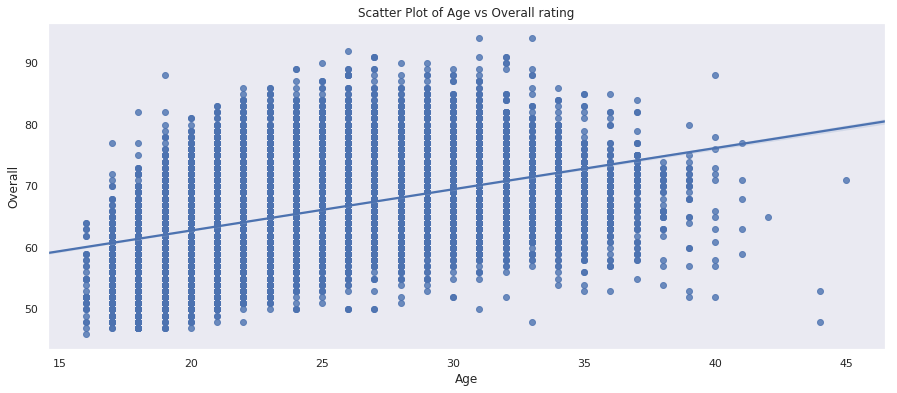

In [20]:
plt.figure(1 , figsize = (15 , 6))
sns.regplot(df['Age'] , df['Overall'])
plt.title('Scatter Plot of Age vs Overall rating')
plt.show()

## Age distribution in few of the famous clubs

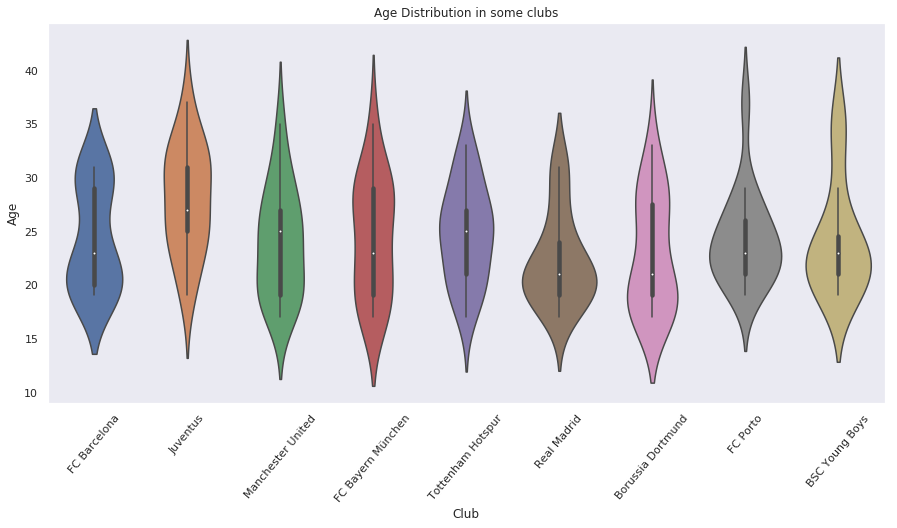

In [21]:
vals = ['Tottenham Hotspur' , 'Juventus' , 'Paris Sain-Germain' ,'FC Bayern München',
       'Real Madrid' , 'FC Barcelona' , 'Borussia Dortmund' , 'Manchester United' , 
       'FC Porto' , 'As Monaco' , 'BSC Young Boys']
df_club_age = df.loc[df['Club'].isin(vals) & df['Age']]
plt.figure(1 , figsize = (15 ,7))
sns.violinplot(x = 'Club' , y = 'Age' , data = df_club_age)
plt.title('Age Distribution in some clubs')
plt.xticks(rotation = 50)
plt.show()

## Age distribution in few countries

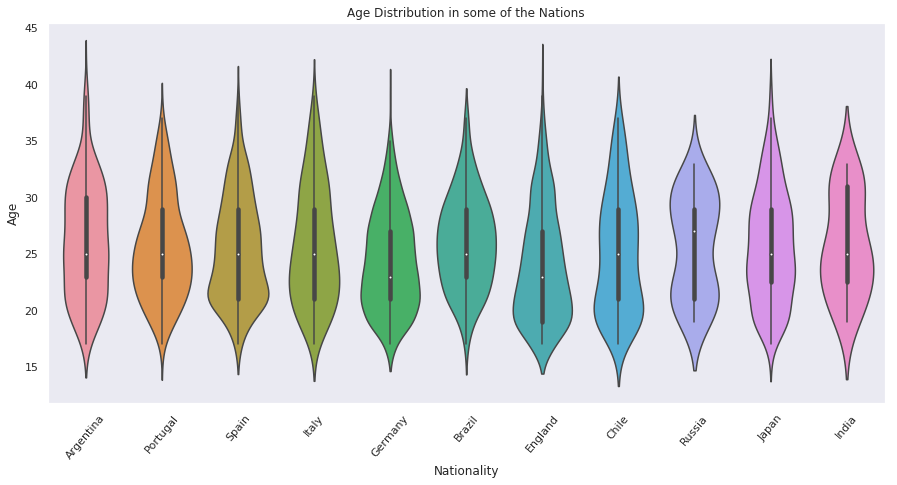

In [22]:
vals = ['England' , 'Brazil' , 'Portugal' ,'Argentina',
       'Italy' , 'Spain' , 'Germany' , 'Russia' , 
       'Chile' , 'Japan' , 'India']
df_club_age = df.loc[df['Nationality'].isin(vals) & df['Age']]
plt.figure(1 , figsize = (15 ,7))
sns.violinplot(x = 'Nationality' , y = 'Age' , data = df_club_age)
plt.title('Age Distribution in some of the Nations')
plt.xticks(rotation = 50)
plt.show()

### Maximum number of players belong to which country?

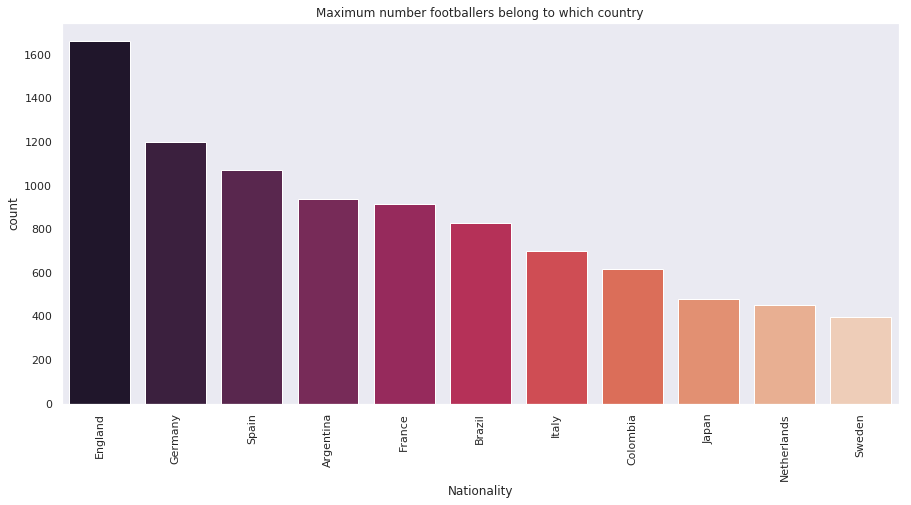

In [23]:
plt.figure(1 , figsize = (15 , 7))
countries = []
c = counter(df['Nationality']).most_common()[:11]
for n in range(11):
    countries.append(c[n][0])

sns.countplot(x  = 'Nationality' ,
              data = df[df['Nationality'].isin(countries)] ,
              order  = df[df['Nationality'].isin(countries)]['Nationality'].value_counts().index , 
             palette = 'rocket') 
plt.xticks(rotation = 90)
plt.title('Maximum number footballers belong to which country' )
plt.show()


<center>
    <h2>Maximum players belong to England</h2>
<img src = "https://vignette.wikia.nocookie.net/logopedia/images/b/b5/England_national_football_team_logo_%282004-2009%29.png/revision/latest?cb=20160513211823" width = 100 height = 100>
</center>

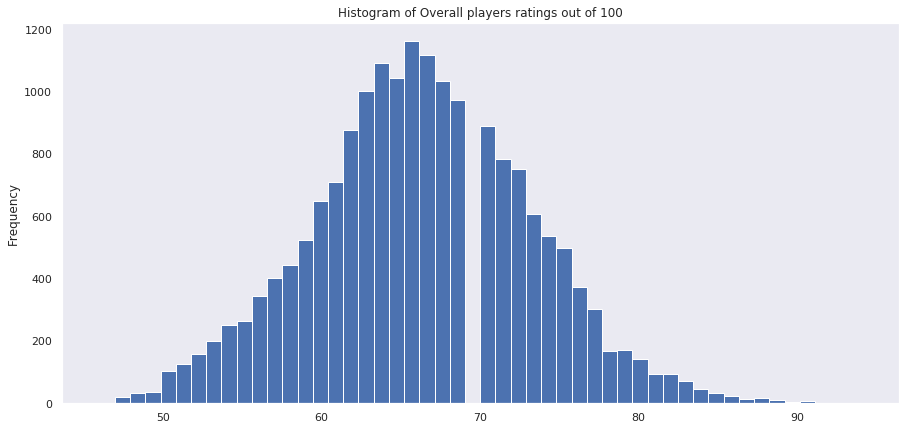

In [24]:
plt.figure(1 , figsize = (15 , 7))
df['Overall'].plot(kind = 'hist' , bins = 50 )
plt.title('Histogram of Overall players ratings out of 100')
plt.show()

## Top 20 players

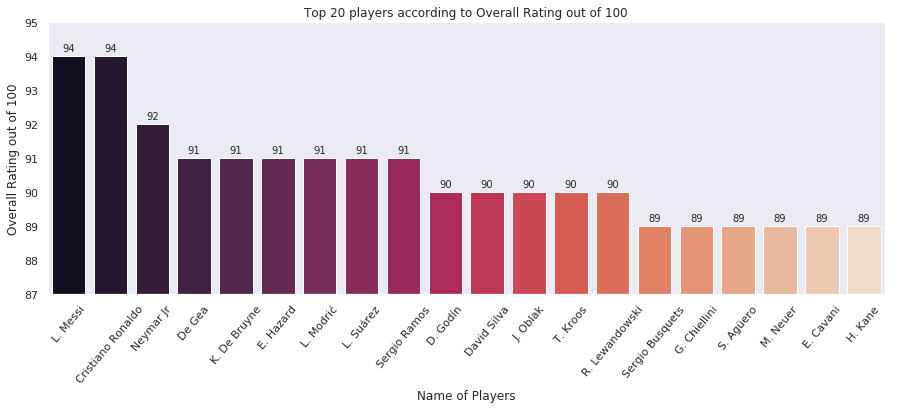

In [25]:
df_best_players = pd.DataFrame.copy(df.sort_values(by = 'Overall' , 
                                                   ascending = False ).head(20))

plt.figure(1 , figsize = (15 , 5))
plots.bar_plot(x ='Name' , y = 'Overall' , data = df_best_players , 
              x_tick_rotation = 50 , xlabel = 'Name of Players' , 
              ylabel = 'Overall Rating out of 100' ,
               title = 'Top 20 players according to Overall Rating out of 100')
plt.ylim(87 , 95)
plt.show()

<center>
    <img src = "http://as00.epimg.net/img/comunes/fotos/fichas/deportistas/c/cri/large/14558.png" width = 100 height = 100 >
    <h3>Cristiano Ronaldo</h3>
    <img src = "https://as01.epimg.net/img/comunes/fotos/fichas/deportistas/m/mes/large/15167.png" width = 100 height = 100>
    <h3> Messi </h3>
    <img src = "https://pngimage.net/wp-content/uploads/2018/06/neymar-face-png-7.png" width = 100 >
    <h3>Neymar Jr.</h3>
    <img src = "http://pesway.ru/newbase/players/1936.png" width = 100 height = 100>
    <h3>De Gea</h3>
</center>

In [9]:
player_features = ['Crossing', 'Finishing', 'HeadingAccuracy',
       'ShortPassing', 'Volleys', 'Dribbling', 'Curve', 'FKAccuracy',
       'LongPassing', 'BallControl', 'Acceleration', 'SprintSpeed',
       'Agility', 'Reactions', 'Balance', 'ShotPower', 'Jumping',
       'Stamina', 'Strength', 'LongShots', 'Aggression', 'Interceptions',
       'Positioning', 'Vision', 'Penalties', 'Composure', 'Marking',
       'StandingTackle', 'SlidingTackle', 'GKDiving', 'GKHandling',
       'GKKicking', 'GKPositioning', 'GKReflexes']

## Top 20 clubs with best players.

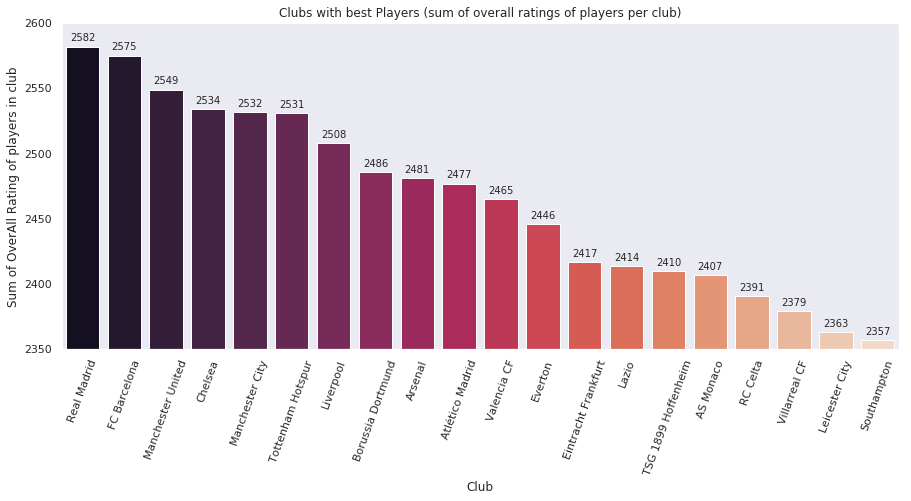

In [27]:
best_dict = {}
for club in df['Club'].unique():
    overall_rating = df['Overall'][df['Club'] == club].sum()
    best_dict[club] = overall_rating
df_bcp = pd.DataFrame.from_dict(best_dict , orient = 'index' , 
                                                 columns = ['overall'])
df_bcp['club'] = df_bcp.index
df_bcp = df_bcp.sort_values(by = 'overall' , ascending =  False)

plt.figure(1 , figsize = (15 , 6))
plots.bar_plot(x = 'club' , y  = 'overall' , data = df_bcp.head(20) , 
              x_tick_rotation = 70 , xlabel = 'Club' , 
              ylabel = 'Sum of OverAll Rating of players in club',
              title = 'Clubs with best Players (sum of overall ratings of players per club)')
plt.ylim(2350 , 2600)
plt.show()

![rm](https://www.101greatgoals.com/wp-content/uploads/2017/10/real-madrid-logo-png-7.png)
<h3> Squad </h3>

In [28]:
df[df["Club"] == "Real Madrid"][['Name' , 'Position' , 'Overall' , 'Age']]

,Name,Position,Overall,Age
6,L. Modrić,RCM,91,32
8,Sergio Ramos,RCB,91,32
11,T. Kroos,LCM,90,28
19,T. Courtois,GK,89,26
27,Casemiro,CDM,88,26
30,Isco,LW,88,26
35,Marcelo,LB,88,30
36,G. Bale,ST,88,28
46,K. Navas,GK,87,31
62,R. Varane,RCB,86,25


## Top 10 Countries with best player

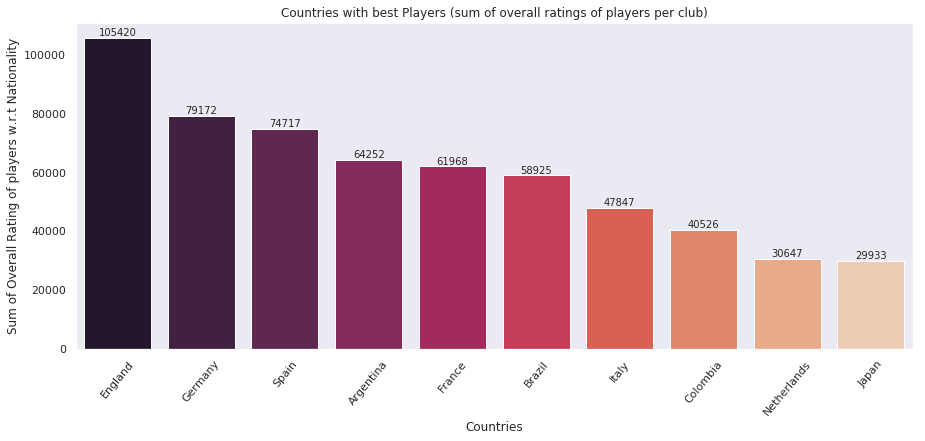

In [29]:
best_dict = {}
for nation in df['Nationality'].unique():
    overall_rating = df['Overall'][df['Nationality'] == nation].sum()
    best_dict[nation] = overall_rating
df_bnp = pd.DataFrame.from_dict(best_dict , orient = 'index' , 
                                                 columns = ['overall'])
df_bnp['nation'] = df_bnp.index
df_bnp = df_bnp.sort_values(by = 'overall' , ascending =  False)

plt.figure(1 , figsize = (15 , 6))
plots.bar_plot(x = 'nation' , y = 'overall' , data = df_bnp.head(10) , 
              x_tick_rotation = 50 , xlabel = 'Countries' , 
              ylabel = 'Sum of Overall Rating of players w.r.t Nationality',
              title = 'Countries with best Players (sum of overall ratings of players per club)')
plt.show()

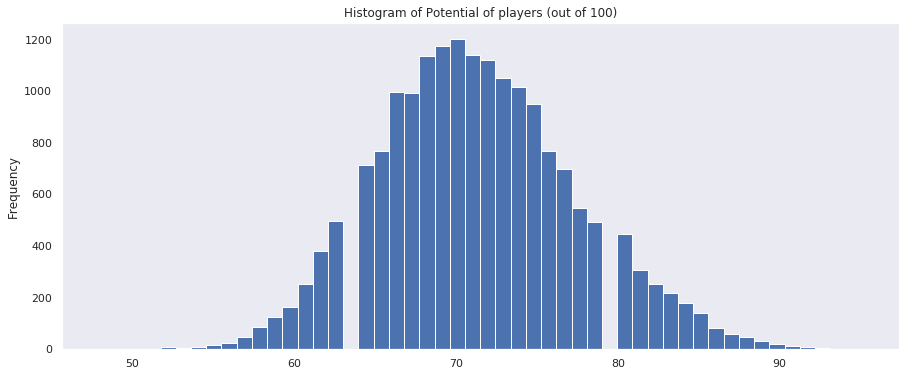

In [30]:
plt.figure(1 , figsize = (15 , 6))
df['Potential'].plot(kind = 'hist' , bins = 50)
plt.title('Histogram of Potential of players (out of 100)')
plt.show()

In [25]:
def cleaning_value(x):
    if '€' in str(x) and 'M' in str(x):
        c = str(x).replace('€' , '')
        c = str(c).replace('M' , '')
        c = float(c) * 1000000
        
    else:
        c = str(x).replace('€' , '')
        c = str(c).replace('K' , '')
        c = float(c) * 1000
            
    return c

fn = lambda x : cleaning_value(x)

df['Value_num'] = df['Value'].apply(fn)

## Top 5 expensive players to buy.

In [32]:
df.sort_values(by = 'Value_num' , ascending = False)[['Name' , 'Club' , 'Nationality' , 
                                                     'Overall' , 'Value' , 'Wage']].head(5)

,Name,Club,Nationality,Overall,Value,Wage
2,Neymar Jr,Paris Saint-Germain,Brazil,92,€118.5M,€290K
0,L. Messi,FC Barcelona,Argentina,94,€110.5M,€565K
4,K. De Bruyne,Manchester City,Belgium,91,€102M,€355K
5,E. Hazard,Chelsea,Belgium,91,€93M,€340K
15,P. Dybala,Juventus,Argentina,89,€89M,€205K


## Top 5 player who have great shot power

In [33]:
df.sort_values(by = 'ShotPower' , ascending = False)[['Name' , 'Club' , 'Nationality' , 
                                                     'ShotPower' ]].head(5)

,Name,Club,Nationality,ShotPower
1,Cristiano Ronaldo,Juventus,Portugal,95.0
378,Hulk,Shanghai SIPG FC,Brazil,94.0
1348,F. Guarín,Shanghai Greenland Shenhua FC,Colombia,93.0
890,L. Podolski,Vissel Kobe,Germany,92.0
36,G. Bale,Real Madrid,Wales,92.0


## Top 5 players who can give best long passes

In [34]:
df.sort_values(by = 'LongPassing' , ascending = False)[['Name' , 'Club' , 'Nationality' , 
                                                     'LongPassing']].head(5)

,Name,Club,Nationality,LongPassing
11,T. Kroos,Real Madrid,Germany,93.0
4,K. De Bruyne,Manchester City,Belgium,91.0
45,P. Pogba,Manchester United,France,90.0
53,I. Rakitić,FC Barcelona,Croatia,90.0
219,Cesc Fàbregas,Chelsea,Spain,89.0


## Top 5 players who have best vision

In [35]:
df.sort_values(by = 'Vision' , ascending = False)[['Name' , 'Club' , 'Nationality' , 
                                                     'Vision' ]].head(5)

,Name,Club,Nationality,Vision
0,L. Messi,FC Barcelona,Argentina,94.0
4,K. De Bruyne,Manchester City,Belgium,94.0
76,Iniesta,Vissel Kobe,Spain,93.0
13,David Silva,Manchester City,Spain,92.0
6,L. Modrić,Real Madrid,Croatia,92.0


## Histograms of player features.

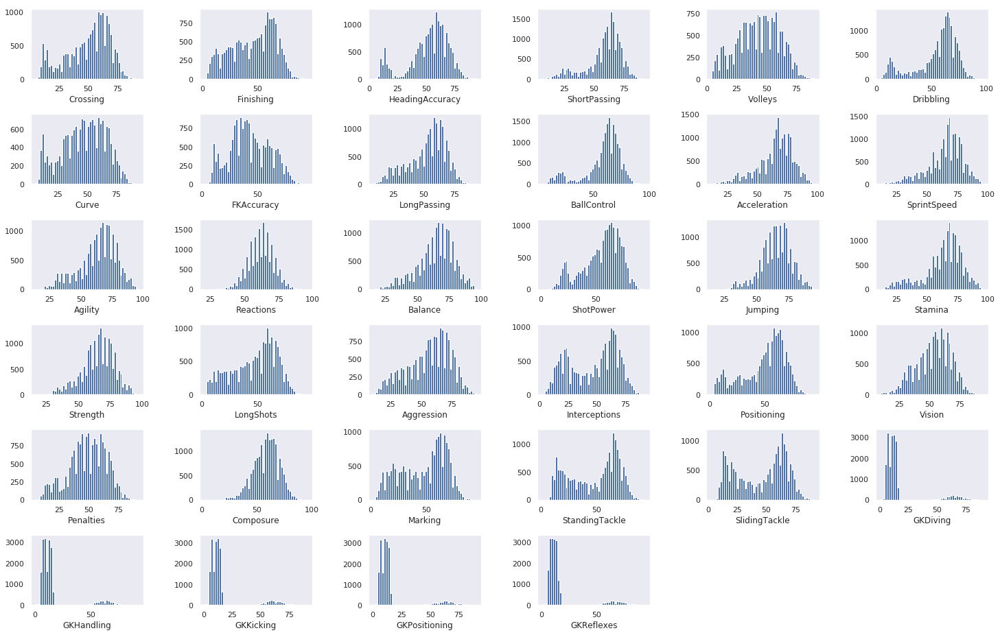

In [36]:
plt.figure(1 , figsize = (25 , 16))
n = 0
for feat in player_features:
    n += 1
    plt.subplot(6 , 6 , n)
    plt.subplots_adjust(hspace = 0.5 , wspace = 0.5)
    df[feat].plot(kind = 'hist' , bins = 50)
    plt.ylabel('')
    plt.xlabel(feat)

plt.show()

## Shot power used while passing

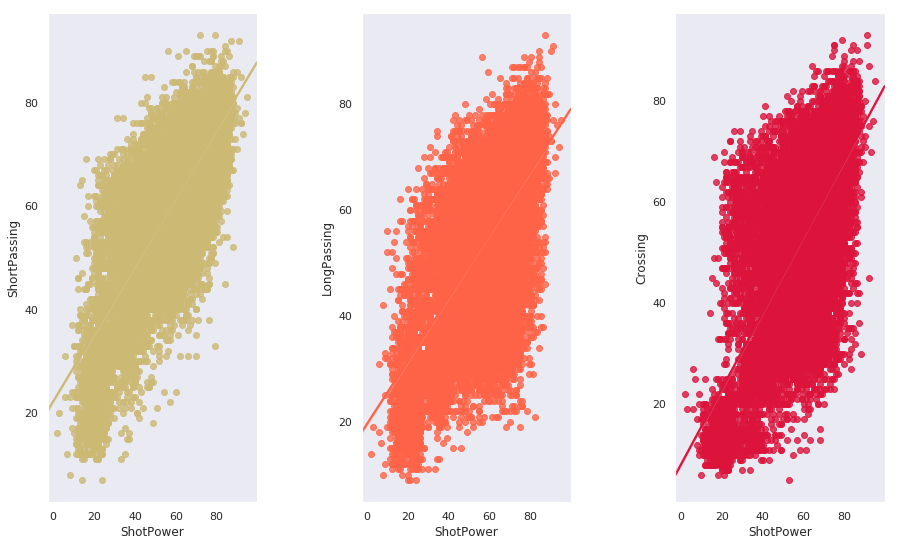

In [37]:
vals = ['ShortPassing' , 'LongPassing' , 'Crossing']
plt.figure(1 , figsize = (15 , 9))
plots.regplot_one_vs_many(x = 'ShotPower' , y = vals , data = df , 
                         rows = 1 , cols = 3)
plt.show()

 ## Ball Control while dribbling , acceleration and sprint    

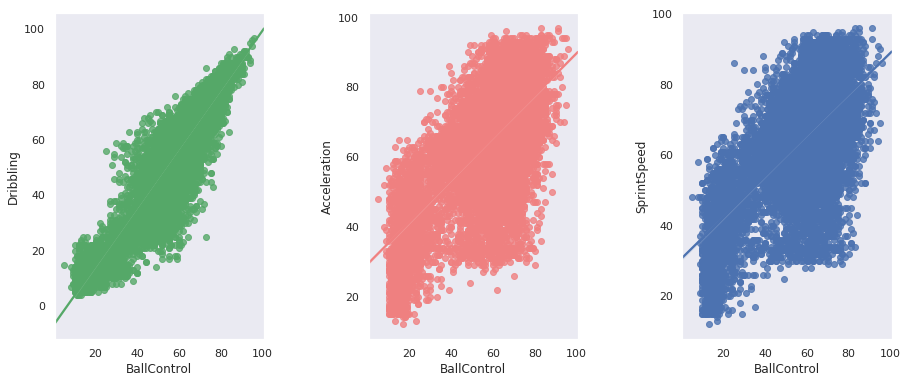

In [38]:
vals = ['Dribbling' , 'Acceleration' , 'SprintSpeed']
plt.figure(1 , figsize = (15 , 6))
plots.regplot_one_vs_many(x = 'BallControl' , y = vals , data = df , 
                         rows = 1 , cols = 3)
plt.show()

## Finishing at 5 scenarios 

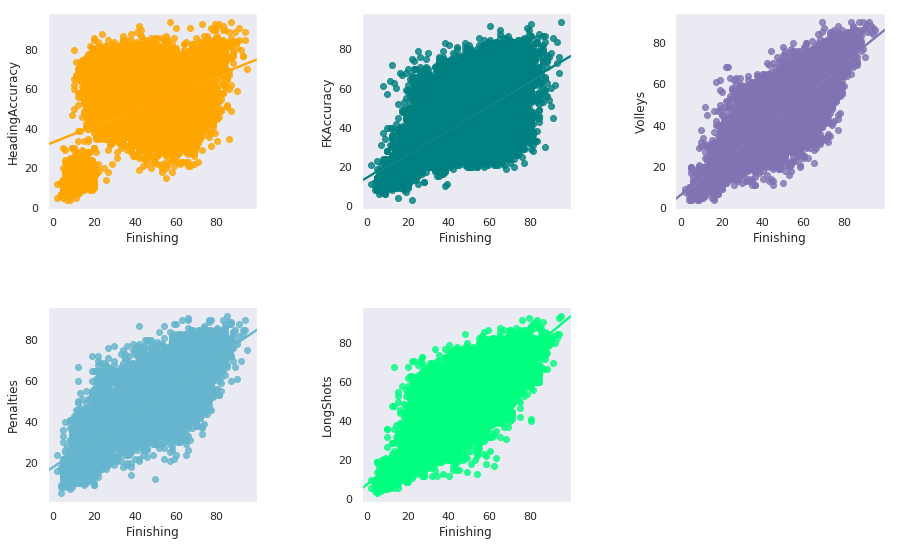

In [39]:
vals = ['HeadingAccuracy' , 'FKAccuracy' , 'Volleys' , 'Penalties' , 'LongShots']
plt.figure(1 , figsize = (15 , 9))
plots.regplot_one_vs_many(x = 'Finishing', y = vals , data = df , 
                         rows = 2 , cols = 3)
plt.show()

In [10]:
def scatter3D(x , y , z , txt , xlabel , ylabel , zlabel , title):
    camera = dict(
        up=dict(x=0, y=0, z=1),
        center=dict(x=0, y=0, z=0),
        eye=dict(x=2, y=2, z=0.1))
    trace0 = go.Scatter3d(
        x = x,
        y = y,
        z = z,
        mode = 'markers',
        text  = txt,
        marker = dict(
            size = 12,
            color = z,
            colorscale = 'Viridis',
            showscale = True,
            line = dict(
                color = 'rgba(217 , 217 , 217 , 0.14)',
                width = 0.5
            ),
            opacity = 0.8
        )
    )
    
    layout = go.Layout(
        title = title,
        scene = dict(
            camera = camera,
            xaxis = dict(title  = xlabel),
            yaxis = dict(title  = ylabel),
            zaxis = dict(title  = zlabel)
        )
    )
    data = [trace0]
    fig = go.Figure(data = data , layout = layout)
    py.offline.iplot(fig)

In [11]:
scatter3D(df['Acceleration'].where(df['Acceleration'] > 80) ,
         df['Composure'].where(df['Composure'] > 80),
         df['Finishing'].where(df['Finishing'] > 80), 
         df['Name'],
         'Acceleration' , 
         'Composure',
         'Finishing',
         'Best Finishers')

### Messi's clean finish 
![me](https://media.giphy.com/media/5y0c1KoZrCajBKtoBT/giphy.gif)

In [12]:
scatter3D(df['LongPassing'].where(df['LongPassing'] > 85) ,
         df['ShortPassing'].where(df['ShortPassing'] > 85) , 
         df['Vision'].where(df['Vision'] > 85) , 
         df['Name'],
         'Long passing' , 'Short passing' , 'Vision' , 
         'Players who can give amazing assits or passes')

### Kevin De Bruyne
![kd](http://www.squawka.com/en/wp-content/uploads/2018/09/GettyImages-944631802.jpg)

In [13]:
scatter3D(df['Volleys'].where(df['Volleys'] > 80) ,
         df['Curve'].where(df['Curve'] > 80),
         df['ShotPower'].where(df['ShotPower'] > 80),
         df['Name'],
         'Volleys','Curve' , 'Shot Power',
         'Players who can score lightning fast Volley goals')

### Cristiano Ronaldo scoring an amazing volley goal
![v](https://i.pinimg.com/originals/d0/4c/24/d04c240fada114f48bd33a51d5d8d0a9.gif)

In [14]:
scatter3D(df['Finishing'].where(df['Finishing'] > 80) ,
         df['Vision'].where(df['Vision'] > 80),
         df['Penalties'].where(df['Penalties'] > 80),
         df['Name'],
         'Finishing','Vision' , 'Penalties',
         'Players who can take perfect penalties')

### M Reus scoring a penalty
![me](http://giant.gfycat.com/MediocreEarlyDoctorfish.gif)

In [15]:
scatter3D(df['Dribbling'].where(df['Dribbling'] > 85) ,
         df['SprintSpeed'].where(df['SprintSpeed'] > 85),
         df['Finishing'].where(df['Finishing'] > 85),
         df['Name'],
         'Dribbling','Sprint Speed' , 'Finishing',
         'Players who can score amazing solo goals.')

### Cristiano Ronaldo solo goal
![csg](https://thumbs.gfycat.com/AlienatedNearGourami-small.gif)
### Messi solo goal
![msg](https://thumbs.gfycat.com/AnguishedGiantAndeancondor-size_restricted.gif)


In [16]:
scatter3D(df['Skill Moves'].where(df['Skill Moves'] >= 0.4) ,
         df['BallControl'].where(df['BallControl'] > 85),
         df['Reactions'].where(df['Reactions'] > 85),
         df['Name'],
         'Skill Moves', 'Ball Control' , 'Reactions',
         'Players with amazing footwork. ')

### Ronaldos insane skills  
![skil](http://crazyegypt.com/wp-content/uploads/2016/12/Skills-Cristiano-Ronaldo-CR7.gif)

In [17]:
scatter3D(df['HeadingAccuracy'].where(df['HeadingAccuracy'] > 85) ,
         df['Jumping'].where(df['Jumping'] > 85),
         df['Finishing'].where(df['Finishing'] > 85),
         df['Name'],
         'Heading Acc', 'Jumping' , 'Finishing',
         'Players who can score header goal from a corner at crucial time')

### Cristiano Ronaldo scoring a header from  a corner
![he](https://i.imgur.com/twEOLqM.gif?noredirect)

In [18]:
scatter3D(df['Vision'].where(df['Vision'] > 80) ,
         df['FKAccuracy'].where(df['FKAccuracy'] > 80),
         df['LongPassing'].where(df['LongPassing'] > 80),
         df['Name'],
         'Vision', 'Free kick Acc' , 'Long passing',
         'Freekick specialists')

### Toni Kroos free kick
![fk](https://thumbs.gfycat.com/CapitalViciousLarva-size_restricted.gif)

In [19]:
scatter3D(df['LongShots'].where(df['LongShots'] > 82) ,
         df['ShotPower'].where(df['ShotPower'] > 82),
         df['Finishing'].where(df['Finishing'] > 82),
         df['Name'],
         'LongShots','Shot Power' , 'Finishing',
         'Players who can score from long distance.')

### Ronaldo Scoring a long distance goal
![r7](https://nesncom.files.wordpress.com/2014/01/w24oxdn.gif)

In [20]:
scatter3D(df['SlidingTackle'].where(df['SlidingTackle'] > 80) ,
         df['Strength'].where(df['Strength'] > 80),
         df['Aggression'].where(df['Aggression'] > 80),
         df['Name'],
         'Sliding Tackle','Strenght' , 'Aggression',
         'Badass Defenders.')

### Pepe being pepe
![pbp](https://www.unilad.co.uk/wp-content/uploads/2016/03/Pepe-GIF.gif)

In [21]:
scatter3D(df['Marking'].where(df['Marking'] > 85) ,
         df['Strength'].where(df['Strength'] > 85),
         df['StandingTackle'].where(df['StandingTackle'] > 85),
         df['Name'],
         'Marking','Strength' , 'Standing Tackle',
         'Best Defenders')

### G Chiellini got no chill
![cg](http://i.imgur.com/9fBp90Z.gif)

In [22]:
scatter3D(df['GKDiving'].where(df['GKDiving'] > 85) ,
         df['GKReflexes'].where(df['GKReflexes'] > 85),
         df['GKPositioning'].where(df['GKPositioning'] > 85),
         df['Name'],
         'Diving','Reflexes' , 'Positioning',
         'Best Goal Keepers')

### De Gea the legend
![degea](https://thumbs.gfycat.com/MasculineImpressionableGraywolf-size_restricted.gif)

In [26]:
scatter3D(df['Potential'].where(df['Potential'] > 85) ,
         df['Value_num'].where(df['Value_num'] > 85),
         df['Finishing'].where(df['Finishing'] > 85),
         df['Name'],
         'Potential','Value' , 'Finishing',
         'Attackers who are worth for their value.')

###  Cristiano Ronaldo , Harry Kane and Messi
![kcm](https://goolfm.net/wp-content/uploads/2018/01/Kane-Messi-768x405.jpg)

In [27]:
scatter3D(df['Age'].where(df['Age'] < 22) ,
         df['Finishing'].where(df['Finishing'] > 80),
         df['Potential'].where(df['Potential'] > 80),
         df['Name'],
         'Volleys','Curve' , 'Shot Power',
         'Best attackers with age less than 22')

### Mbappe
![mbp](https://media1.giphy.com/media/3iCpefrEfnrDgvk2az/giphy.gif)

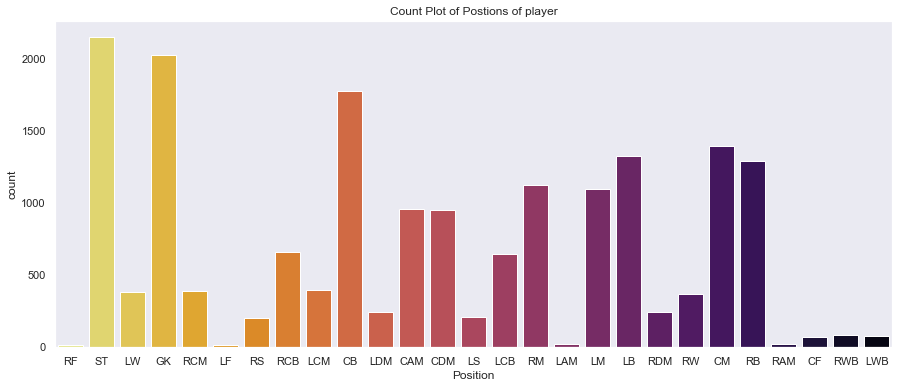

In [28]:
plt.figure(1 , figsize = (15 , 6))
sns.countplot(x = 'Position' , data = df , palette = 'inferno_r' )
plt.title('Count Plot of Postions of player')
plt.show()

## Top 3 important features per position

In [29]:
for i, val in df.groupby(df['Position'])[player_features].mean().iterrows():
    print('Position {}: {}, {}, {}'.format(i, *tuple(val.nlargest(3).index)))

Position CAM: Balance, Agility, Acceleration
Position CB: Strength, Jumping, StandingTackle
Position CDM: Stamina, Aggression, Strength
Position CF: Agility, Balance, Acceleration
Position CM: Balance, ShortPassing, Agility
Position GK: GKReflexes, GKDiving, GKPositioning
Position LAM: Agility, Balance, SprintSpeed
Position LB: SprintSpeed, Acceleration, Stamina
Position LCB: Strength, Jumping, StandingTackle
Position LCM: Stamina, ShortPassing, Balance
Position LDM: Stamina, ShortPassing, Strength
Position LF: Balance, Agility, Acceleration
Position LM: Acceleration, SprintSpeed, Agility
Position LS: SprintSpeed, Strength, Acceleration
Position LW: Acceleration, SprintSpeed, Agility
Position LWB: SprintSpeed, Acceleration, Stamina
Position RAM: Agility, Balance, Acceleration
Position RB: SprintSpeed, Stamina, Acceleration
Position RCB: Strength, Jumping, Aggression
Position RCM: Stamina, ShortPassing, Agility
Position RDM: Stamina, ShortPassing, Aggression
Position RF: Agility, Accele

## Top Five important features plot per postion
this plot was taken from : [Daria Czerniawko](https://www.kaggle.com/dczerniawko/fifa19-analysis)

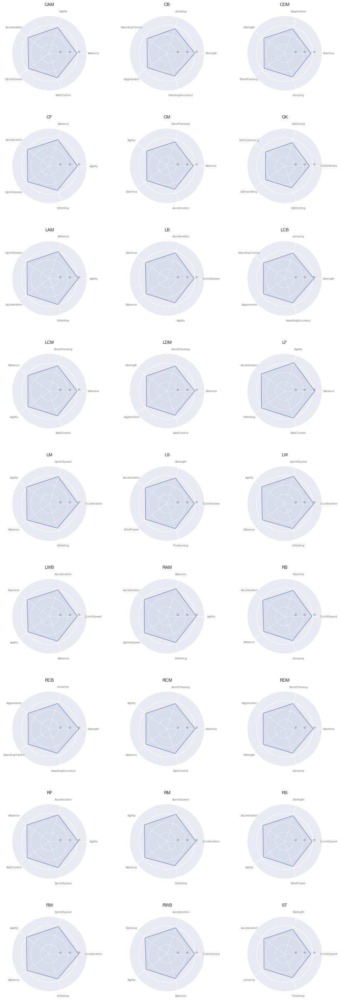

In [30]:
idx = 1
plt.figure(figsize=(15,45))
for position_name, features in df.groupby(df['Position'])[player_features].mean().iterrows():
    top_features = dict(features.nlargest(5))
    
    # number of variable
    categories=top_features.keys()
    N = len(categories)

    # We are going to plot the first line of the data frame.
    # But we need to repeat the first value to close the circular graph:
    values = list(top_features.values())
    values += values[:1]

    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * np.pi for n in range(N)]
    angles += angles[:1]

    # Initialise the spider plot
    ax = plt.subplot(9, 3, idx, polar=True)

    # Draw one axe per variable + add labels labels yet
    plt.xticks(angles[:-1], categories, color='grey', size=8)

    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([25,50,75], ["25","50","75"], color="grey", size=7)
    plt.ylim(0,100)
    
    plt.subplots_adjust(hspace = 0.5)
    
    # Plot data
    ax.plot(angles, values, linewidth=1, linestyle='solid')

    # Fill area
    ax.fill(angles, values, 'b', alpha=0.1)
    
    plt.title(position_name, size=11, y=1.1)
    
    idx += 1 

In [32]:
df_postion  = pd.DataFrame()
for position_name, features in df.groupby(df['Position'])[player_features].mean().iterrows():
    top_features = dict(features.nlargest(5))
    df_postion[position_name] = tuple(top_features)
df_postion.head()

,CAM,CB,CDM,CF,CM,GK,LAM,LB,LCB,LCM,LDM,LF,LM,LS,LW,LWB,RAM,RB,RCB,RCM,RDM,RF,RM,RS,RW,RWB,ST
0,Balance,Strength,Stamina,Agility,Balance,GKReflexes,Agility,SprintSpeed,Strength,Stamina,Stamina,Balance,Acceleration,SprintSpeed,Acceleration,SprintSpeed,Agility,SprintSpeed,Strength,Stamina,Stamina,Agility,Acceleration,SprintSpeed,Acceleration,SprintSpeed,SprintSpeed
1,Agility,Jumping,Aggression,Balance,ShortPassing,GKDiving,Balance,Acceleration,Jumping,ShortPassing,ShortPassing,Agility,SprintSpeed,Strength,SprintSpeed,Acceleration,Balance,Stamina,Jumping,ShortPassing,ShortPassing,Acceleration,SprintSpeed,Strength,SprintSpeed,Acceleration,Strength
2,Acceleration,StandingTackle,Strength,Acceleration,Agility,GKPositioning,SprintSpeed,Stamina,StandingTackle,Balance,Strength,Acceleration,Agility,Acceleration,Agility,Stamina,Acceleration,Acceleration,Aggression,Agility,Aggression,Balance,Agility,Acceleration,Agility,Stamina,Acceleration
3,SprintSpeed,Aggression,ShortPassing,SprintSpeed,Stamina,GKHandling,Acceleration,Balance,Aggression,Agility,Aggression,Dribbling,Balance,ShotPower,Balance,Agility,SprintSpeed,Balance,StandingTackle,Balance,Strength,BallControl,Balance,Agility,Balance,Agility,Jumping
4,BallControl,HeadingAccuracy,Jumping,Dribbling,Acceleration,GKKicking,Dribbling,Agility,HeadingAccuracy,BallControl,BallControl,BallControl,Dribbling,Positioning,Dribbling,Balance,Dribbling,Jumping,HeadingAccuracy,BallControl,Jumping,SprintSpeed,Dribbling,ShotPower,Dribbling,Balance,Finishing


# Dream Team According to stats

In [33]:
posi = []
player = []
club_l = []
for col in df_postion.columns:
    tmp_df = pd.DataFrame()
    #print(col)
    l = [df_postion[col].values]
    l = l[0]
    l = list(l)
    l.append('Name')
    tmp_df = pd.DataFrame.copy(df[df['Position'] == col][l])
    tmp_df['mean'] = np.mean(tmp_df.iloc[: , :-1] , axis = 1)
    name = tmp_df['Name'][tmp_df['mean'] == tmp_df['mean'].max()].values[0]
    club = df['Club'][df['Name'] == str(name)].values[0]
    posi.append(col)
    player.append(name)
    club_l.append(club)
    #print('{0} \nClub : {1}'.format(name ,club ) )
gk = ['GK']
forward = ['LS', 'ST', 'RS','LF', 'CF', 'RF']
midfeilder = ['LW','RW', 'LAM', 'CAM', 'RAM', 'LM', 'LCM', 'CM',
              'RCM', 'RM', 'LDM', 'CDM', 'RDM' ]
defenders = ['LWB','RWB', 'LB', 'LCB', 'CB',]

print('GoalKeeper : ')
for p , n , c in zip(posi , player , club_l):
    if p in gk:
        print('{} [Club : {} , Position : {}]'.format(n , c , p))
print('\nFORWARD : ')
for p , n , c in zip(posi , player , club_l):
    if p in forward:
        print('{} [Club : {} , Position : {}]'.format(n , c , p))
print('\nMIDFEILDER : ')
for p , n , c in zip(posi , player , club_l):
    if p in midfeilder:
        print('{} [Club : {} , Position : {}]'.format(n , c , p))
print('\nDEFENDER : ')
for p , n , c in zip(posi , player , club_l):
    if p in defenders:
        print('{} [Club : {} , Position : {}]'.format(n , c , p))

GoalKeeper : 
De Gea [Club : Manchester United , Position : GK]

FORWARD : 
S. Giovinco [Club : Toronto FC , Position : CF]
E. Hazard [Club : Chelsea , Position : LF]
J. Martínez [Club : Atlanta United , Position : LS]
L. Messi [Club : FC Barcelona , Position : RF]
A. Saint-Maximin [Club : OGC Nice , Position : RS]
Cristiano Ronaldo [Club : Juventus , Position : ST]

MIDFEILDER : 
H. Nakagawa [Club : Kashiwa Reysol , Position : CAM]
Casemiro [Club : Real Madrid , Position : CDM]
N. Keïta [Club : Liverpool , Position : CM]
Paulo Daineiro [Club : Ceará Sporting Club , Position : LAM]
David Silva [Club : Manchester City , Position : LCM]
N. Kanté [Club : Chelsea , Position : LDM]
Douglas Costa [Club : Juventus , Position : LM]
Neymar Jr [Club : Paris Saint-Germain , Position : LW]
J. Cuadrado [Club : Juventus , Position : RAM]
L. Modrić [Club : Real Madrid , Position : RCM]
P. Pogba [Club : Manchester United , Position : RDM]
Gelson Martins [Club : Atlético Madrid , Position : RM]
R. Ster

In [34]:
CAM = 'H. Nakagawa'
CB = 'D. Godín'
CDM = 'Casemiro'
CF = 'S. Giovinco'
CM = 'N. Keïta'
GK = 'De Gea'
LAM = 'Paulo Daineiro'
LB = 'Jordi Alba'
LCB = 'G. Chiellini'
LCM = 'David Silva'
LDM = 'N. Kanté' 
LF = 'E. Hazard' 
LM = 'Douglas Costa' 
LS = 'J. Martínez' 
LW = 'Neymar Jr' 
LWB = 'M. Pedersen' 
RAM = 'J. Cuadrado' 
RB = 'Nélson Semedo' 
RCB = 'Sergio Ramos' 
RCM = 'L. Modrić' 
RDM = 'P. Pogba' 
RF = 'L. Messi' 
RM = 'Gelson Martins' 
RS = 'A. Saint-Maximin' 
RW = 'R. Sterling' 
RWB = 'M. Millar' 
ST = 'Cristiano Ronaldo' 

In [35]:
def create_football_formation(formation = [] , label_1 = None ,
                              label_2 = None , label_3 = None ,
                              label_4 = None,label_4W = None ,
                              label_5 = None , label_3W = None):
    
    plt.scatter(x = [1] , y = [6] , s = 300 , color = 'blue')
    plt.annotate('De Gea \n(Manchester United)' , (1 - 0.5 , 6 + 0.5))
    plt.plot(np.ones((11 , ))*1.5 , np.arange(1 , 12) , 'w-')
    plt.plot(np.ones((5 , ))*0.5 , np.arange(4 , 9) , 'w-')
    
    n = 0
    for posi in formation:
        if posi ==  1:
            n += 3
            dot = plt.scatter(x = [n]  , y = [6] , s = 400 , color = 'white')
            plt.scatter(x = [n]  , y = [6] , s = 300 , color = 'red')
            for i, txt in enumerate(label_1):
                txt = str(txt+'\n('+df['Club'][df['Name'] == txt].values[0]+')')
                plt.annotate(txt, ( n-0.5 , 6+0.5))
            
        elif posi == 2:
            n += 3
            y = [5 , 7.5]
            x = [ n , n ]
            plt.scatter(x  , y , s = 400 , color = 'white')
            plt.scatter(x  , y , s = 300 , color = 'red')
            for i, txt in enumerate(label_2):
                txt = str(txt+'\n('+df['Club'][df['Name'] == txt].values[0]+')') 
                plt.annotate(txt, (x[i] - 0.5, y[i]+0.5))
        elif posi == 3:
            n+=3
            y = [3.333 , 6.666 , 9.999]
            x = [n , n  , n ]
            plt.scatter(x  , y , s = 400 , color = 'white')
            plt.scatter(x  , y , s = 300 , color = 'red')
            for i, txt in enumerate(label_3):
                txt = str(txt+'\n('+df['Club'][df['Name'] == txt].values[0]+')')
                plt.annotate(txt, (x[i] - 0.5, y[i]+0.5))
            
            if not label_3W == None:
                n+=3
                y = [3.333 , 6.666 , 9.999]
                x = [n , n  , n ]
                plt.scatter(x  , y , s = 400 , color = 'white')
                plt.scatter(x  , y , s = 300 , color = 'red')
                for i, txt in enumerate(label_3W):
                    txt = str(txt+'\n('+df['Club'][df['Name'] == txt].values[0]+')')
                    plt.annotate(txt, (x[i] - 0.5, y[i]+0.5))
            
        elif posi == 4 and not label_4 == None:
            n+=3
            y = [2.5 , 5 , 7.5 , 10]
            x = [n , n  , n , n ]
            plt.scatter(x  , y , s = 400 , color = 'white')
            plt.scatter(x  , y , s = 300 , color = 'red')
            for i, txt in enumerate(label_4):
                txt = str(txt+'\n('+df['Club'][df['Name'] == txt].values[0]+')')
                plt.annotate(txt, (x[i] - 0.5, y[i]+0.5))
                
            if not label_4W == None:
                n+=3
                y = [2.5 , 5 , 7.5 , 10]
                x = [n , n  , n , n ]
                plt.scatter(x  , y , s = 400 , color = 'white')
                plt.scatter(x  , y , s = 300 , color = 'red')
                for i, txt in enumerate(label_4W):
                    txt = str(txt+'\n('+df['Club'][df['Name'] == txt].values[0]+')')
                    plt.annotate(txt, (x[i] - 0.5, y[i]+0.5))
                
                
        elif posi == 5:
            n+=3
            y = [2 , 4 , 6 , 8 , 10]
            x = [n , n , n  , n  , n]
            plt.scatter(x  , y , s = 400 , color = 'white')
            plt.scatter(x  , y , s = 300 , color = 'red')
            for i, txt in enumerate(label_5):
                txt = str(txt+'\n('+df['Club'][df['Name'] == txt].values[0]+')')
                plt.annotate(txt, (x[i] - 0.5, y[i]+0.5))
            
    plt.plot(np.ones((5 , ))*(n+0.5) , np.arange(4 , 9) , 'w-')
    plt.plot(np.ones((11 , ))*(n/2) , np.arange(1 , 12) , 'w-')
    plt.yticks([])
    plt.xticks([])
    ax = plt.gca()
    ax.set_facecolor('tab:green')            

## Dream team in different formations 

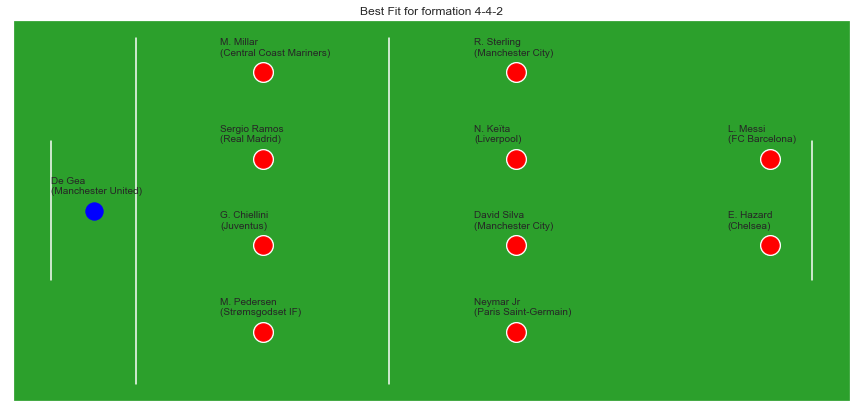

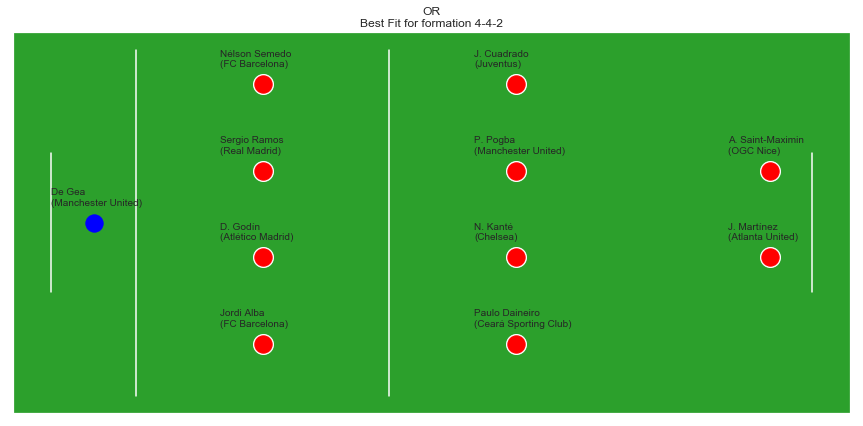

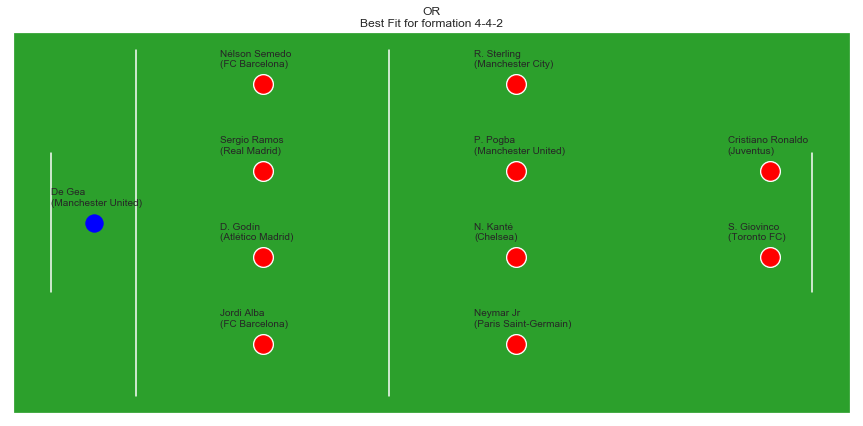

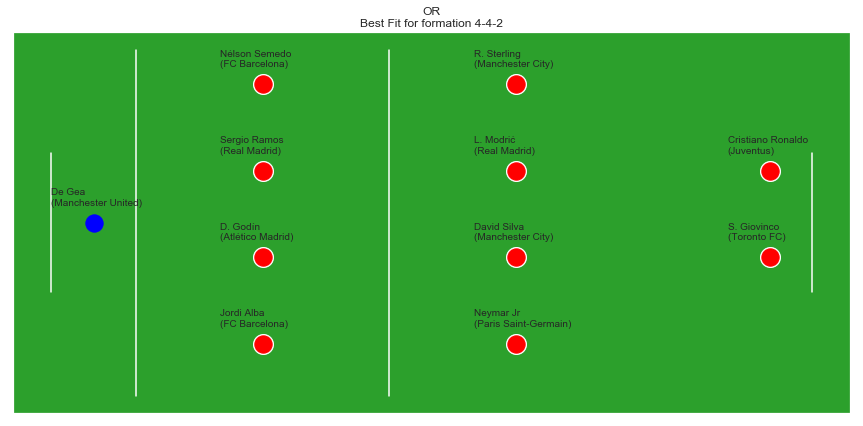

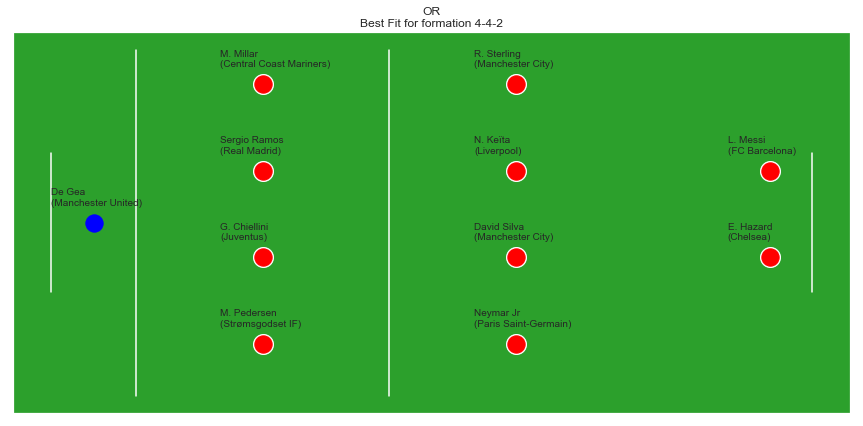

...

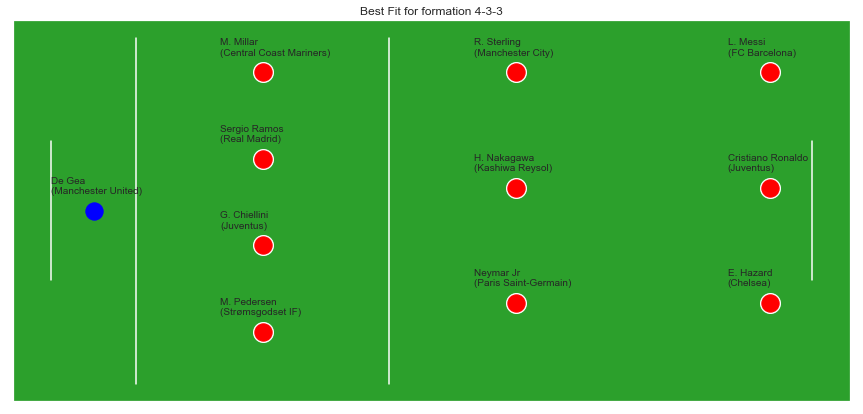

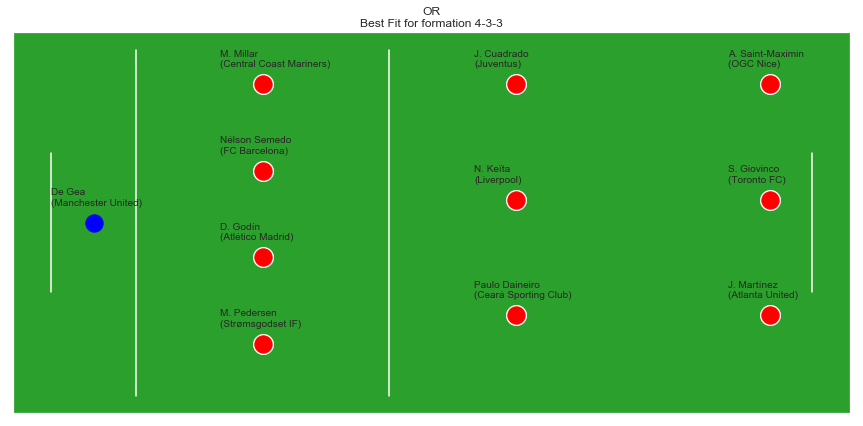

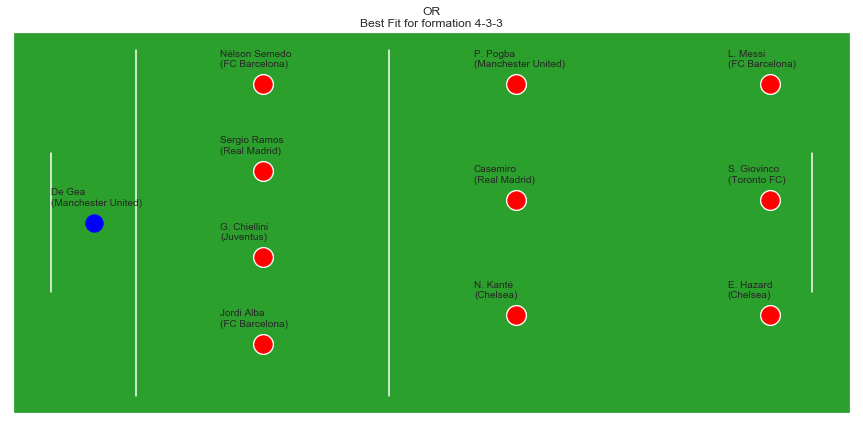

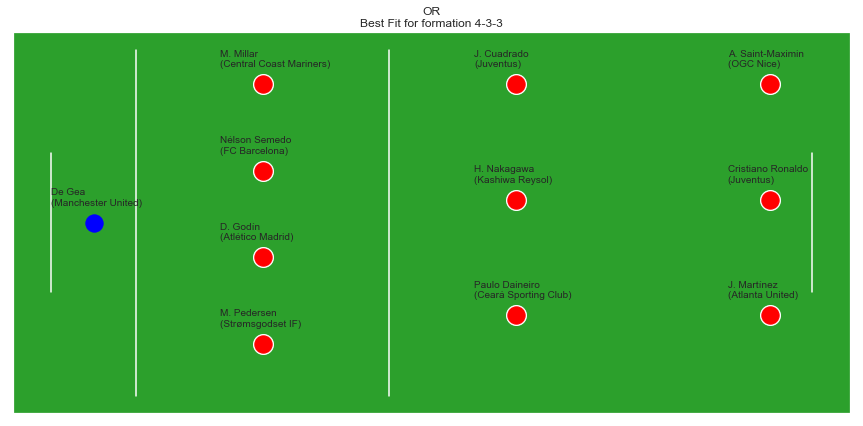

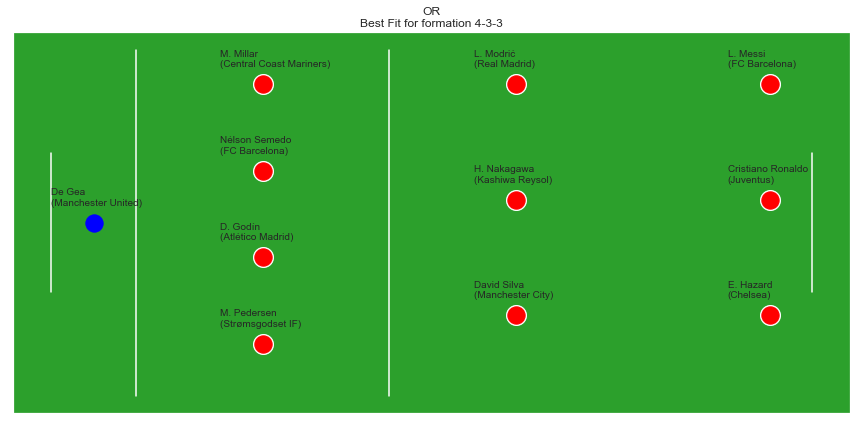

In [36]:
plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 2 ] , 
                         label_4 = [LWB , LCB , RCB , RWB],
                         label_4W = [LW , LCM , CM , RW],
                         label_2 = [LF , RF],
                         )
plt.title('Best Fit for formation 4-4-2')
plt.show()

plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 2 ] , 
                         label_4 = [LB , CB , RCB , RB],
                         label_4W = [LAM , LDM , RDM , RAM],
                         label_2 = [LS , RS],
                         )
plt.title('OR\nBest Fit for formation 4-4-2')
plt.show()


plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 2 ] , 
                         label_4 = [LB , CB , RCB , RB],
                         label_4W = [LW , LDM , RDM , RW],
                         label_2 = [CF , ST],
                         )
plt.title('OR\nBest Fit for formation 4-4-2')
plt.show()


plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 2 ] , 
                         label_4 = [LB , CB , RCB , RB],
                         label_4W = [LW , LCM , RCM , RW],
                         label_2 = [CF , ST],
                         )
plt.title('OR\nBest Fit for formation 4-4-2')
plt.show()

plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 2 ] , 
                         label_4 = [LWB , LCB , RCB , RWB],
                         label_4W = [LW , LCM , CM , RW],
                         label_2 = [LF , RF],
                         )
plt.title('OR\nBest Fit for formation 4-4-2')
plt.show()


plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 2 , 3 , 1] , 
                         label_4 = [LWB , LCB , RCB , RWB],
                         label_2 = [LCM , RCM],
                         label_3 = [LF , CAM , RF],
                         label_1 = [ST])
plt.title('Best Fit for formation 4-2-3-1')
plt.show()

plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 2 , 3 , 1] , 
                         label_4 = [LWB , LB , RB , RWB],
                         label_2 = [LAM , RAM],
                         label_3 = [LW , CF , RW],
                         label_1 = [ST])
plt.title('OR\nBest Fit for formation 4-2-3-1')
plt.show()

plt.figure(1 , figsize = (15 , 7))
create_football_formation(formation = [ 4 , 2 , 3 , 1] , 
                         label_4 = [LWB , CB , RCB , RWB],
                         label_2 = [CM , CAM],
                         label_3 = [LF , CM , RF],
                         label_1 = [ST])
plt.title('OR\nBest Fit for formation 4-2-3-1')

plt.show()

plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 2 , 3 , 1] , 
                         label_4 = [LWB , LCB , RCB , RWB],
                         label_2 = [LCM , RCM],
                         label_3 = [LDM , CAM , RDM],
                         label_1 = [ST])
plt.title('OR\nBest Fit for formation 4-2-3-1')
plt.show()

plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 5, 4 , 1 ] , 
                         label_5 = [LWB , LCB , CB , RCB , RWB],
                         label_4 = [LW, LDM , RDM , RW],
                         label_1 = [ST])
plt.title('Best Fit for formation 5-4-1')
plt.show()

plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 3 ] , 
                         label_4 = [LWB , LCB , RCB , RWB],
                         label_3 = [LW, CAM , RW],
                         label_3W = [LF , ST , RF])
plt.title('Best Fit for formation 4-3-3')
plt.show()


plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 3 ] , 
                         label_4 = [LWB , CB , RB , RWB],
                         label_3 = [LAM, CM , RAM],
                         label_3W = [LS , CF , RS])
plt.title('OR\nBest Fit for formation 4-3-3')
plt.show()

plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 3 ] , 
                         label_4 = [LB , LCB , RCB , RB],
                         label_3 = [LDM, CDM , RDM],
                         label_3W = [LF , CF , RF])
plt.title('OR\nBest Fit for formation 4-3-3')
plt.show()

plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 3] , 
                         label_4 = [LWB , CB , RB , RWB],
                         label_3 = [LAM, CAM , RAM],
                         label_3W = [LS , ST , RS])
plt.title('OR\nBest Fit for formation 4-3-3')
plt.show()


plt.figure(1 , figsize = (15 , 7))           
create_football_formation(formation = [ 4 , 3] , 
                         label_4 = [LWB , CB , RB , RWB],
                         label_3 = [LCM, CAM , RCM],
                         label_3W = [LF , ST , RF])
plt.title('OR\nBest Fit for formation 4-3-3')
plt.show()



# Young Dream team according to stats

In [37]:
df_young = pd.DataFrame.copy(df[df['Age'] <=22])
df_position_y = pd.DataFrame.copy(df_postion)
del df_position_y['RAM']
df_young.head()
posi = []
player = []
club_l = []
for col in df_position_y.columns:
    tmp_df = pd.DataFrame()
    #print(col)
    l = [df_postion[col].values]
    l = l[0]
    l = list(l)
    l.append('Name')
    tmp_df = pd.DataFrame.copy(df_young[df_young['Position'] == col][l])
    tmp_df['mean'] = np.mean(tmp_df.iloc[: , :-1] , axis = 1)
    name = tmp_df['Name'][tmp_df['mean'] == tmp_df['mean'].max()].values[0]
    club = df_young['Club'][df_young['Name'] == str(name)].values[0]
    
    posi.append(col)
    player.append(name)
    club_l.append(club)
    
print('GoalKeeper : ')
for p , n , c in zip(posi , player , club_l):
    if p in gk:
        print('{} [Club : {} , Position : {} , Age : {}]'.format(n , c , p ,
                                                                df['Age'][df['Name'] == n].values[0]))

print('\nFORWARD : ')
for p , n , c in zip(posi , player , club_l):
    if p in forward:
        print('{} [Club : {} , Position : {} , Age : {}]'.format(n , c , p , 
                                                                df['Age'][df['Name'] == n].values[0]))
print('\nMIDFEILDER : ')
for p , n , c in zip(posi , player , club_l):
    if p in midfeilder:
        print('{} [Club : {} , Position : {} , Age : {}]'.format(n , c , p , 
                                                                df['Age'][df['Name'] == n].values[0]))
print('\nDefender : ')
for p , n , c in zip(posi , player , club_l):
    if p in defenders:
        print('{} [Club : {} , Position : {} , Age : {}]'.format(n , c , p , 
                                                                df['Age'][df['Name'] == n].values[0]))

GoalKeeper : 
G. Donnarumma [Club : Milan , Position : GK , Age : 19]

FORWARD : 
Z. Sanogo [Club : TSV Hartberg , Position : CF , Age : 21]
F. Amuzu [Club : RSC Anderlecht , Position : LF , Age : 18]
H. Lozano [Club : PSV , Position : LS , Age : 22]
Rafa Mir [Club : UD Las Palmas , Position : RF , Age : 21]
A. Saint-Maximin [Club : OGC Nice , Position : RS , Age : 21]
E. Boateng [Club : Levante UD , Position : ST , Age : 22]

MIDFEILDER : 
T. Buhagiar [Club : Sydney FC , Position : CAM , Age : 20]
S. Ascacíbar [Club : VfB Stuttgart , Position : CDM , Age : 21]
M. Dahoud [Club : Borussia Dortmund , Position : CM , Age : 22]
F. Sakala [Club : KV Oostende , Position : LAM , Age : 21]
L. Torreira [Club : Arsenal , Position : LCM , Age : 22]
W. Ndidi [Club : Leicester City , Position : LDM , Age : 21]
Daniel Podence [Club : Olympiacos CFP , Position : LM , Age : 22]
L. Sané [Club : Manchester City , Position : LW , Age : 22]
A. Cubas [Club : Club Atlético Talleres , Position : RCM , Age : 